# Configuraciones Preliminares

## Importación de archivos

In [1]:
!wget https://github.com/DiegoPincheiraIb/EL7008_Assignments/raw/main/Assignment_3/Material_tarea_3.zip

--2022-02-23 22:09:16--  https://github.com/DiegoPincheiraIb/EL7008_Assignments/raw/main/Assignment_3/Material_tarea_3.zip
Resolving github.com (github.com)... 140.82.114.4
Connecting to github.com (github.com)|140.82.114.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/DiegoPincheiraIb/EL7008_Assignments/main/Assignment_3/Material_tarea_3.zip [following]
--2022-02-23 22:09:16--  https://raw.githubusercontent.com/DiegoPincheiraIb/EL7008_Assignments/main/Assignment_3/Material_tarea_3.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1361246 (1.3M) [application/zip]
Saving to: ‘Material_tarea_3.zip’

Material_tarea_3.zi 100%[===================>]   1.30M  --.-KB/s    in 0.05s   

2022-02-23 22

In [2]:
!unzip Material_tarea_3.zip

Archive:  Material_tarea_3.zip
   creating: imgs/
  inflating: imgs/uch012a.jpg        
  inflating: imgs/uch012b.jpg        
 extracting: imgs/uch084a.jpg        
 extracting: imgs/uch084b.jpg        
 extracting: imgs/uch098a.jpg        
 extracting: imgs/uch098b.jpg        
  inflating: imgs/uch101a.jpg        
  inflating: imgs/uch101b.jpg        
  inflating: Pauta tarea 3 2020 v01.pdf  
  inflating: Tarea3-2020-v07.pdf     


In [3]:
!ls

 imgs		       'Pauta tarea 3 2020 v01.pdf'   Tarea3-2020-v07.pdf
 Material_tarea_3.zip   sample_data


## Librerías

In [4]:
!pip install sparse

     |████████████████████████████████| 77 kB 1.6 MB/s 


In [5]:
!pip install ipython-autotime

In [6]:
!pip install -U opencv-python

     |████████████████████████████████| 60.4 MB 28 kB/s 
  Attempting uninstall: opencv-python
    Found existing installation: opencv-python 4.1.2.30
    Uninstalling opencv-python-4.1.2.30:
      Successfully uninstalled opencv-python-4.1.2.30
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


In [7]:
%load_ext autotime

time: 132 µs (started: 2022-02-23 22:09:42 +00:00)


In [8]:
from google.colab.patches import cv2_imshow
import math
import random
import sparse
import numpy as np
import cv2
from matplotlib import pyplot as plt

time: 1.07 s (started: 2022-02-23 22:09:43 +00:00)


# Funciones

### genTransform()

Esta función calcula los elementos $(e,\theta,t_x,t_y)$ provenientes de una transformación de semejanza a partir de un calce y un listado de puntos de interés para dos imágenes.

In [9]:
def genTransform(match, keypoints1, keypoints2):
  σ_1 = keypoints1[match.queryIdx].size 
  σ_2 = keypoints2[match.trainIdx].size
  φ_1 = keypoints1[match.queryIdx].angle * math.pi / 180
  φ_2 = keypoints2[match.trainIdx].angle * math.pi / 180
  e = σ_1 / σ_2
  theta = φ_1 - φ_2
  X_Pru, Y_Pru = keypoints1[match.queryIdx].pt
  X_Ref, Y_Ref = keypoints2[match.trainIdx].pt
  tx = X_Pru - e*(X_Ref*math.cos(theta) - Y_Ref*math.sin(theta))
  ty = Y_Pru - e*(X_Ref*math.sin(theta) + Y_Ref*math.cos(theta))
  return (e, theta, tx, ty)

time: 10.3 ms (started: 2022-02-23 22:09:44 +00:00)


## Trf_Semejanza()

Esta función toma  $(e,\theta,t_x,t_y)$ y un punto (x,y) objetivo, aplicándole una transformación de semejanza a dichos puntos con los parámetros mencionados anteriormente.

In [10]:
def Trf_Semejanza(e_Obj, Theta_Obj, Tx_Obj, Ty_Obj,X_Obj, Y_Obj):
  Cos_Sin_Mx = np.array([[math.cos(Theta_Obj),-math.sin(Theta_Obj)],[math.sin(Theta_Obj),math.cos(Theta_Obj)]])
  Var_Aux = e_Obj * (Cos_Sin_Mx @ np.array([[X_Obj],[Y_Obj]])) + np.array([[Tx_Obj],[Ty_Obj]])
  return Var_Aux

time: 2.91 ms (started: 2022-02-23 22:09:44 +00:00)


## RANSAC()

Dado un conjunto de calces, puntos de interés para dos imágenes, aplica el algoritmo RANSAC utilizando dichos elementos para obtener un subconjunto de calces en base al algoritmo. Es posible variar los parámetros de la cantidad de iteraciones, el umbral del error de posición, y el umbral del consenso ingresando los valores deseados como parámetros opcionales en la función.

In [11]:
def ransac(matches, keypoints1, keypoints2, N = 100, Error_Pos = 100, Umbral_Consenso = 30):
  accepted = []
  # Implementar RANSAC. Se debe elegir un calce al azar y calcular su transformacion de semejanza (e,theta,tx,ty)
  #  usando la funcion genTransform( ) definida arriba
  Consenso = []
  for i in range(N):    
    Match_Obj = random.choices(matches) # Se elige calce al azar
    # Se calculan los parámetros de la transformación:
    e_Obj, Theta_Obj, Tx_Obj, Ty_Obj = genTransform(Match_Obj[0], keypoints1, keypoints2)
    for Matches_Seq in matches:
      X_Pru, Y_Pru = keypoints1[Matches_Seq.queryIdx].pt
      X_Ref, Y_Ref = keypoints2[Matches_Seq.trainIdx].pt
      # Se aplica trf semejanza:
      Vector_Semejanza = Trf_Semejanza(e_Obj, Theta_Obj, Tx_Obj, Ty_Obj,X_Ref, Y_Ref)
      #Se calcula el error:
      Error = np.linalg.norm(Vector_Semejanza - np.array([[X_Pru],[Y_Pru]]))
      if Error <= Error_Pos: # Se evalua el error c/r al error de posicion
        Consenso.append(Matches_Seq)
  # Si el consenso es mayor al umbral, se aceptan los calces del consenso como correctos
    if len(Consenso) >= Umbral_Consenso and len(Consenso) >= len(accepted):
        accepted = Consenso
  return accepted

time: 15.2 ms (started: 2022-02-23 22:09:44 +00:00)


## HOUGH4D()

Dado un conjunto de calces y puntos de interés para dos imágenes, aplica el algoritmo de Hough utilizando dichos elementos para obtener un subconjunto de calces en base al algoritmo. Es posible variar los parámetros del tamaño del bin en posición, en orientación, y número mínimo de votos ingresando los valores deseados como parámetros opcionales en la función.

In [29]:
def hough4d(matches, keypoints1, keypoints2,dxBin = 60, dangBin = 30 ,umbralvotos = 4):
  stored = []
  Max_Votos = 0
  # Parametros de Hough
  dangBin = dangBin * math.pi / 180
  accepted = []

  for Match_Obj in matches: # Se itera sobre los calces en matches
    e_Obj, Theta_Obj, Tx_Obj, Ty_Obj = genTransform(Match_Obj, keypoints1, keypoints2) # Se calcula transformacion
    # Se calculan índices de la celda i,j,k,z utilizando un offset de 500
    i_Obj = np.floor((Tx_Obj/dxBin) + 0.5) + 500
    j_Obj = np.floor((Ty_Obj/dxBin) + 0.5) + 500
    k_Obj = np.floor((Theta_Obj/dangBin) + 0.5) + 500
    z_Obj = np.floor((np.log(e_Obj)/np.log(2.0)) + 0.5) + 500
    Vector_Aux = [i_Obj, j_Obj, k_Obj, z_Obj]
    # Se guardan los índices en la lista "stored"
    stored.append(Vector_Aux)

  # Este codigo permite crear una matriz sparse para almacenar los votos
  if len(stored) == 0:
    return []
  coords = np.transpose( np.array(stored) ).astype(int)
  data = np.ones( len(stored) ).astype(int)
  sm = sparse.COO(coords, data, shape=((1000,) * 4))

  # Se calcula la maxima cantidad de votos usando np.max(sm.data)
  Max_Votos = np.max(sm.data)
  # Si la cantidad de votos es menor que un umbral, retornar una lista vacia
  if Max_Votos < umbralvotos:
    return []
  for Match_Obj in matches: # Se itera nuevamente sobre los calces en "matches"
    e_Obj, Theta_Obj, Tx_Obj, Ty_Obj = genTransform(Match_Obj, keypoints1, keypoints2) # Se calcula transformacion
    # Se calculan índices de la celda i,j,k,z utilizando un offset de 500
    i_Obj = np.int(np.floor((Tx_Obj/dxBin) + 0.5) + 500)
    j_Obj = np.int(np.floor((Ty_Obj/dxBin) + 0.5) + 500)
    k_Obj = np.int(np.floor((Theta_Obj/dangBin) + 0.5) + 500)
    z_Obj = np.int(np.floor((np.log(e_Obj)/np.log(2.0)) + 0.5) + 500)
    # Se calcula la cantidad de votos para esa celda
    Votos = sm[i_Obj,j_Obj,k_Obj,z_Obj]
    # Las correspondencias que voten por la celda mas votada se deben agregar a accepted
    if Votos  == Max_Votos:
      accepted.append(Match_Obj)
  return accepted  

time: 61.1 ms (started: 2022-02-23 22:15:28 +00:00)


## caclAfin()

Esta función calcula la transformación afin mediante minimos cuadrados a partir de "matches". Si no hay suficientes matches, retorna una lista vacía.

In [13]:
def calcAfin(matches, keypoints1, keypoints2):
  if len(matches) < 4:
    print('No hay suficiente cantidad de calces para poder realizar la transformación.')
    print('Se retorna la imagen sin el romboide.')
    return []
  A = np.zeros([len(matches)*2,6])
  B = np.zeros([len(matches)*2,1])
  for Index in range(len(matches)):
    X_Pru, Y_Pru = keypoints1[matches[Index].queryIdx].pt
    X_Ref, Y_Ref = keypoints2[matches[Index].trainIdx].pt
    A[2*Index,:] = np.array([X_Ref, Y_Ref, 0,0,1,0])
    A[2*Index + 1,:] = np.array([0,0, X_Ref, Y_Ref,0,1])
    B[2*Index,:] = np.array([X_Pru])
    B[2*Index + 1,:] = np.array([Y_Pru])
  Inv =  np.linalg.inv(A.T.dot(A))
  Var_Aux = Inv.dot(A.T)

  return Var_Aux.dot(B)

time: 18.2 ms (started: 2022-02-23 22:09:44 +00:00)


## drawProjAfin()

Dado un vector que contiene la información de una transformada afin, y un par "input1" e "input2", detecta donde se encuentra "input1" en "input2", encerrando este en un romboide.

In [14]:
def drawProjAfin(transf, input1, input2):
  if transf == []:
    return cv2_imshow(input2)
  else:
    Esquinas = {
        'Esq1': np.array([[0],[0]]),
        'Esq2': np.array([[0],[len(input1[:,-1])]]),
        'Esq3': np.array([[len(input1[-1,:])],[0]]),
        'Esq4': np.array([[len(input1[-1,:])],[len(input1[:,-1])]]),
    }
    Output = {
        'Esq1': np.zeros([1,1]),
        'Esq2': np.zeros([1,1]),
        'Esq3': np.zeros([1,1]),
        'Esq4': np.zeros([1,1]),
    }
    mxx, mxy, myx, myy, tx, ty = transf
    Matriz_M = np.array([[mxx[0],mxy[0]],[myx[0],myy[0]]])
    Vector_T =  np.array([[tx[0]],[ty[0]]])
    for keys in Esquinas:
      Output[keys] = Matriz_M.dot(Esquinas[keys]) + Vector_T
      Output[keys] = [int(item) for item in Output[keys]]
      print([int(item) for item in Output[keys]])
    print(Output['Esq1'])
    cv2.line(input2, tuple(Output['Esq1']), tuple(Output['Esq2']), 255, 2)
    cv2.line(input2, tuple(Output['Esq2']), tuple(Output['Esq4']), 255, 2)
    cv2.line(input2, tuple(Output['Esq3']), tuple(Output['Esq4']), 255, 2)  
    cv2.line(input2, tuple(Output['Esq1']), tuple(Output['Esq3']), 255, 2)
    cv2_imshow(input2)

time: 29.7 ms (started: 2022-02-23 22:09:44 +00:00)


## filterMatches()

Esta función filtra un conjunto de calces.

In [15]:
# Esta funcion ya esta lista, no debe ser modificada
def filterMatches(matches):
  # Apply ratio test
  points1 = []
  points2 = []
  good = []

  for m,n in matches:
    if m.distance < 0.75*n.distance:  # 0.75
      good.append(m)
      points1.append(kp1[m.queryIdx].pt)
      points2.append(kp2[m.trainIdx].pt)
  return np.array(points1), np.array(points2), good

time: 5.57 ms (started: 2022-02-23 22:09:44 +00:00)


# Ejecución:

Se crea un diccionario que contiene las tuplas de imágenes a utilizar. Posteriormente se itera sobre este, creando los descriptores, puntos de interés y calces correspondientes, filtrando estos últimos con la función filterMatches(). Luego, se aplica el algoritmo de RANSAC y Hough, calculando posteriormente la transformación afin y ocupando la función drawProjAfin() para ilustrar el sector donde se ha localizado al elemento objetivo. A lo largo de este procedimiento, se utiliza la función cv2_imshow() para ilustrar los resultados de los procedimientos.

## Parámetros por defecto

In [16]:
import os
print(os.getcwd())
os.chdir("imgs")
print(os.getcwd())

/content
/content/imgs
time: 4.33 ms (started: 2022-02-23 22:09:44 +00:00)


Matches preliminares:


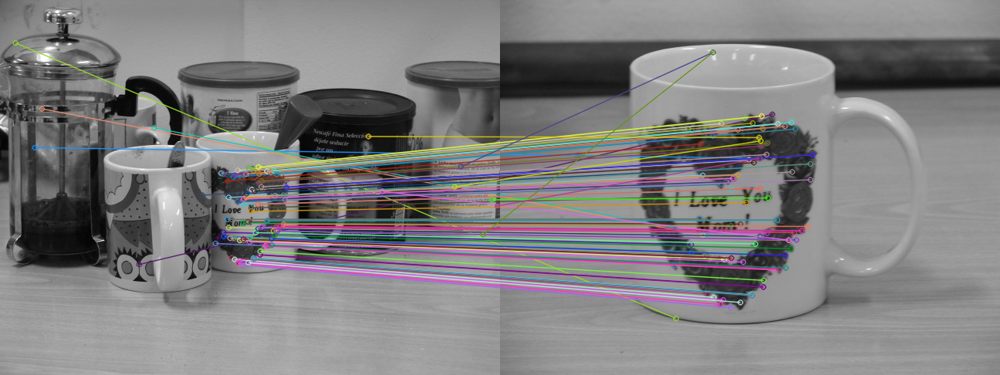

Matches aceptados por RANSAC:


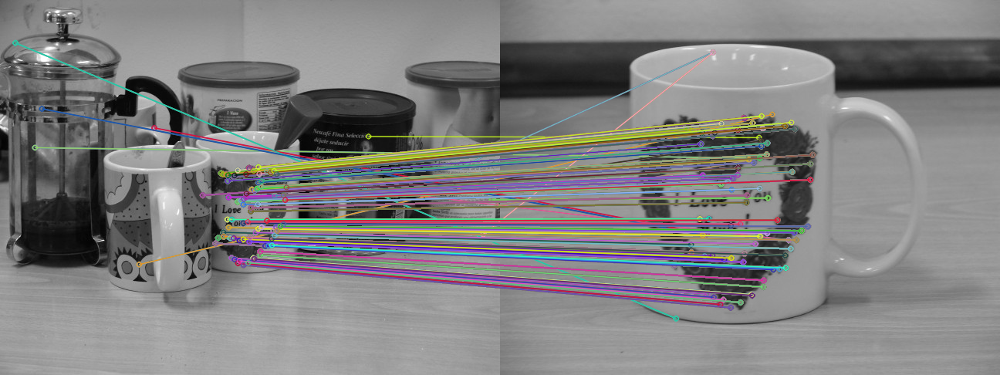

Ubicación del elemento de interés:
[160, 135]
[157, 378]
[497, 149]
[494, 392]
[160, 135]


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  


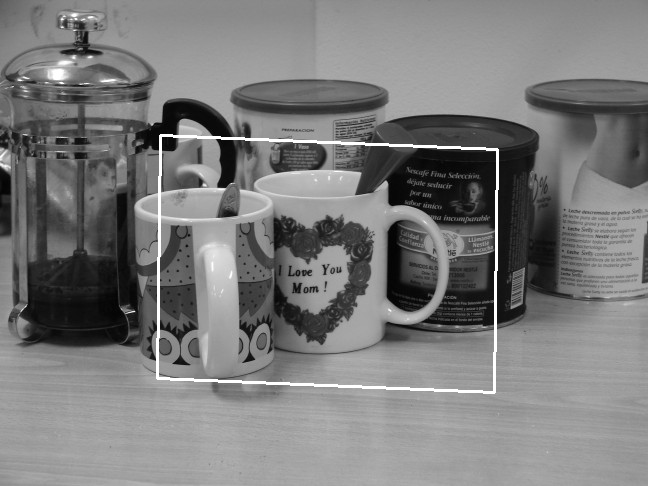

Matches aceptados por Hough:


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:34: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:35: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecat

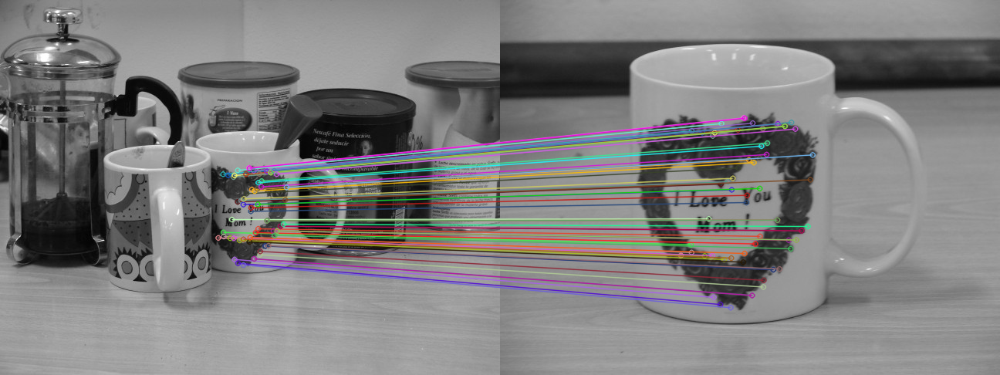

Ubicación del elemento de interés:
[158, 136]
[160, 385]
[494, 142]
[497, 391]
[158, 136]


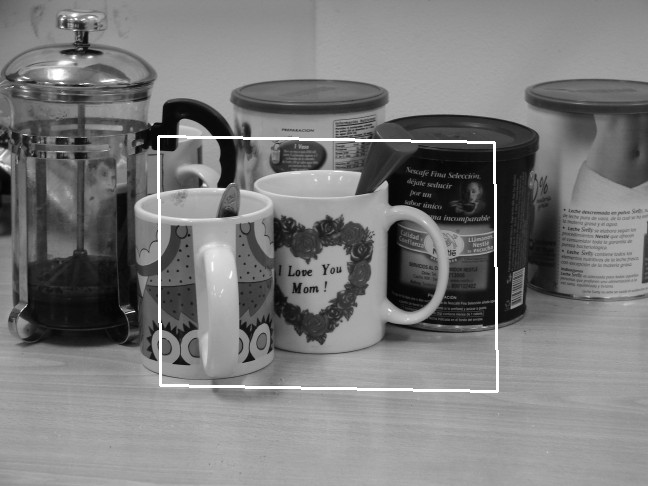

Matches preliminares:


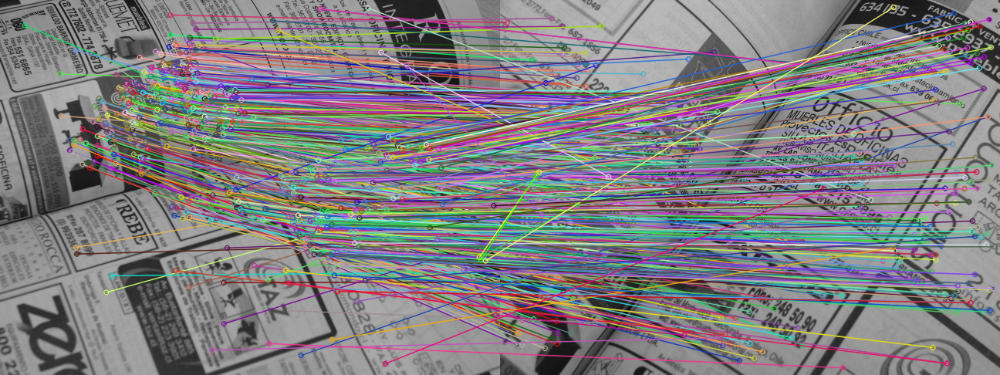

Matches aceptados por RANSAC:


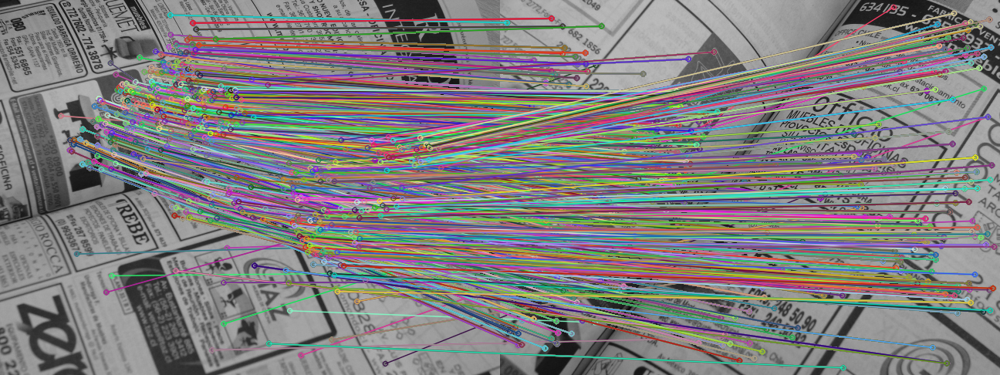

Ubicación del elemento de interés:
[226, 1]
[56, 205]
[579, 187]
[409, 392]
[226, 1]


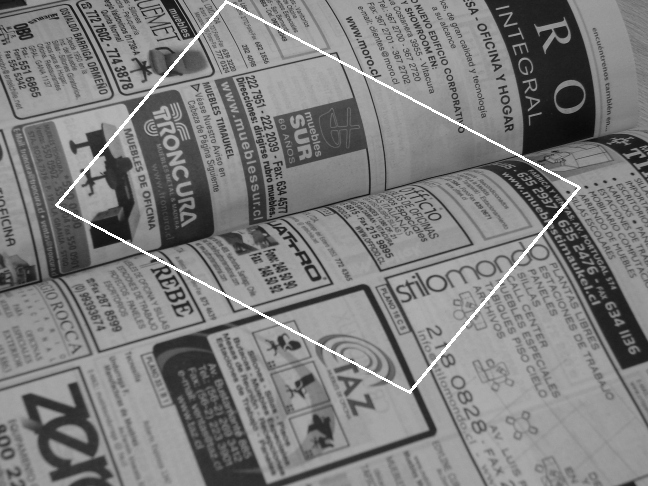

Matches aceptados por Hough:


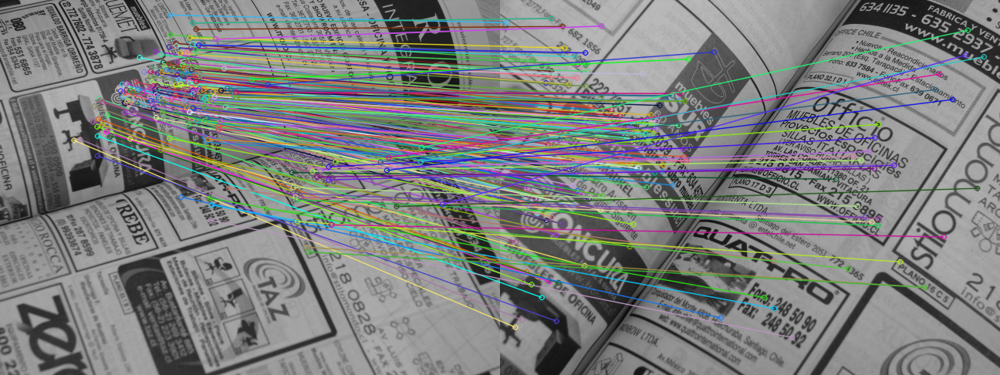

Ubicación del elemento de interés:
[221, -1]
[60, 199]
[574, 192]
[413, 392]
[221, -1]


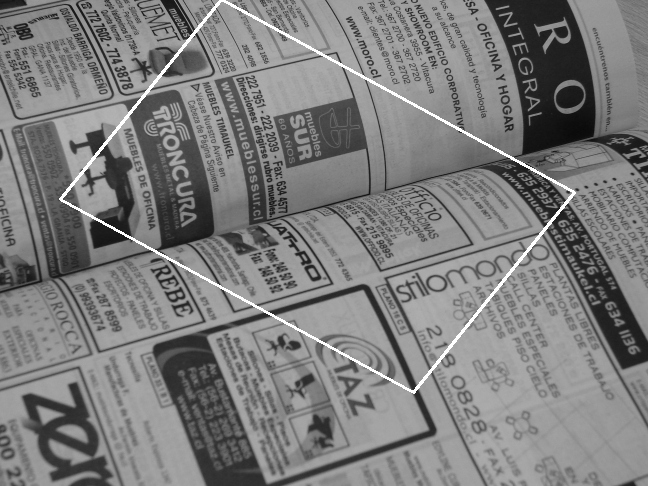

Matches preliminares:


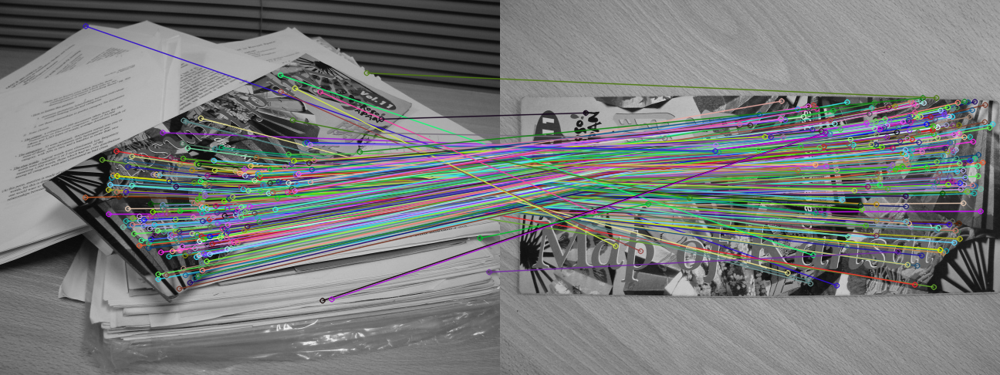

Matches aceptados por RANSAC:


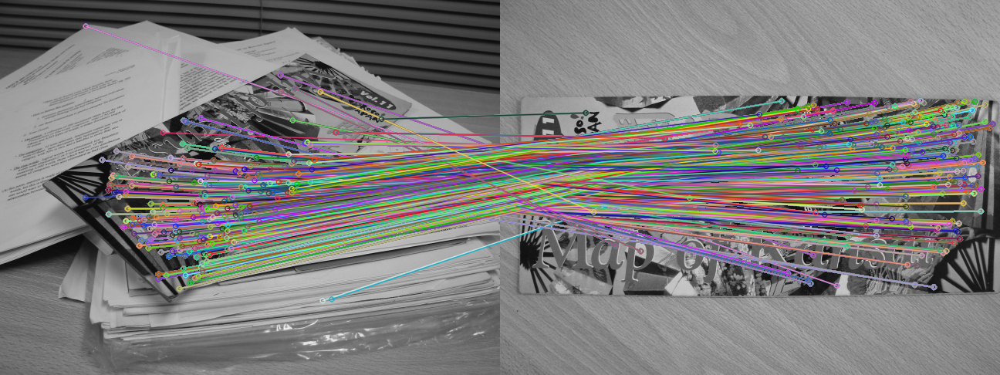

Ubicación del elemento de interés:
[709, 150]
[394, -99]
[314, 429]
[0, 179]
[709, 150]


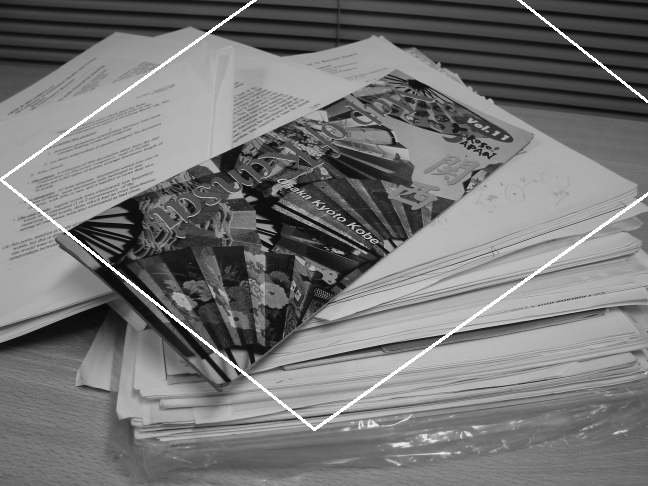

Matches aceptados por Hough:


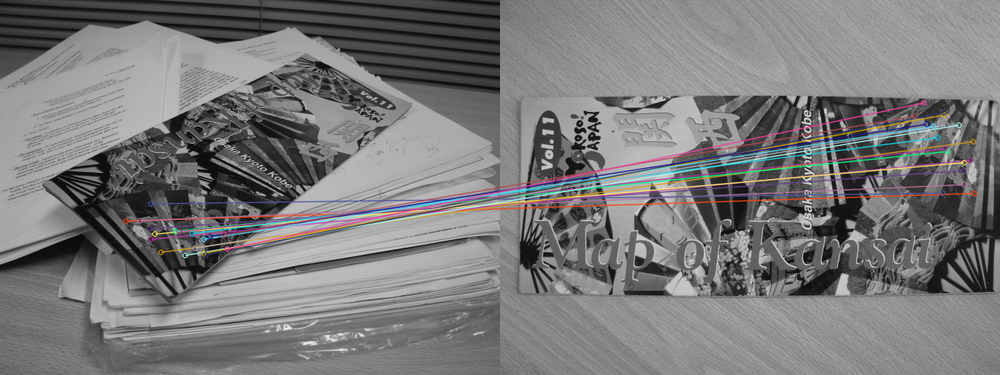

Ubicación del elemento de interés:
[809, 89]
[475, -215]
[308, 462]
[-25, 157]
[809, 89]


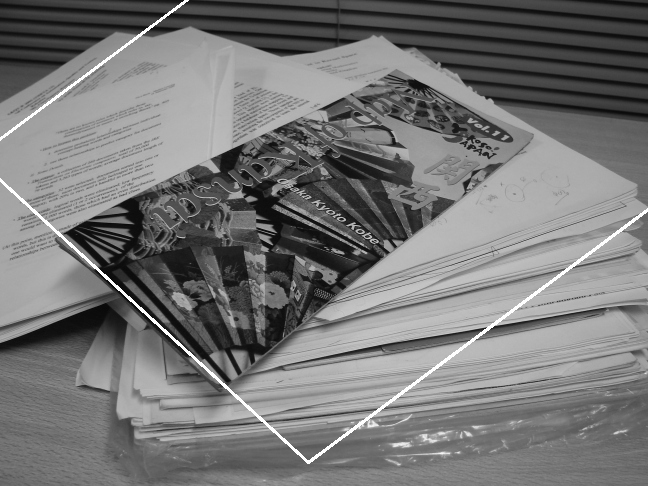

Matches preliminares:


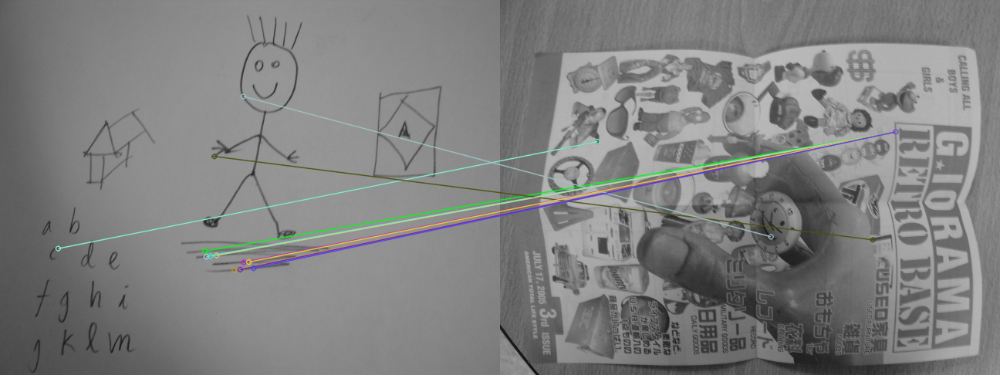

Matches aceptados por RANSAC:


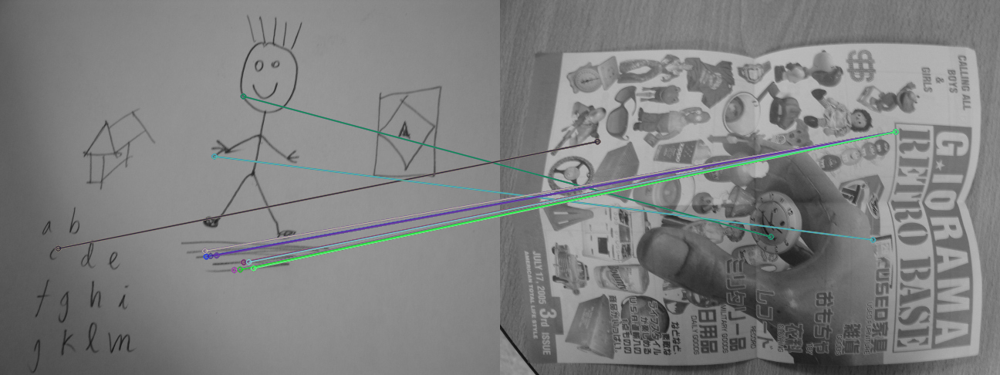

Ubicación del elemento de interés:
[-71, 551]
[141, -73]
[298, 559]
[511, -66]
[-71, 551]


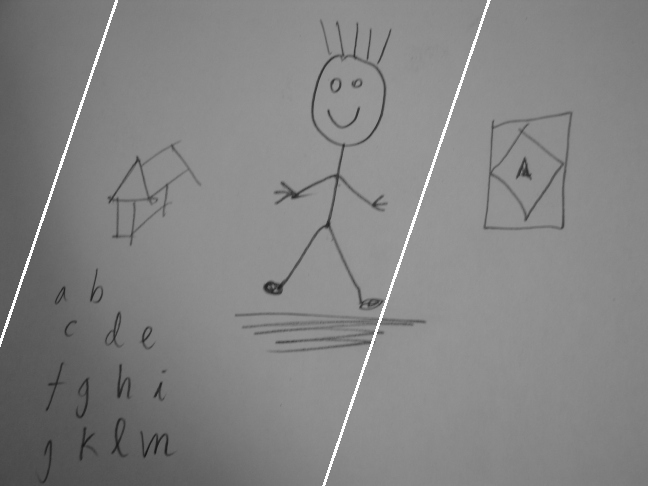

Matches aceptados por Hough:


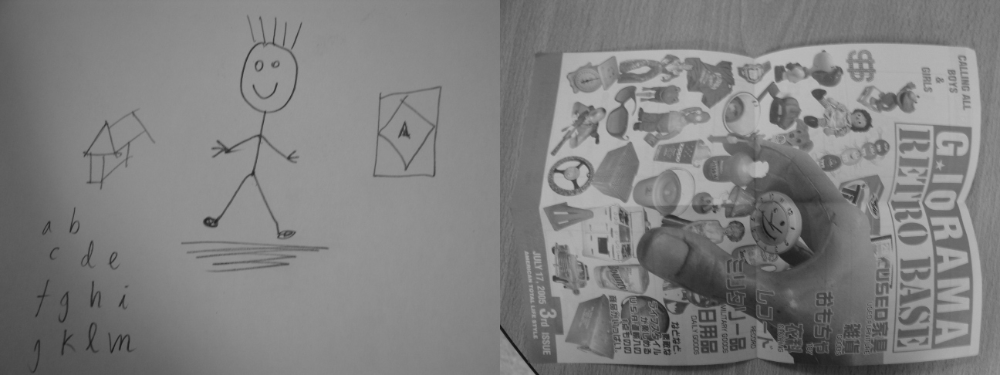

No hay suficiente cantidad de calces para poder realizar la transformación.
Se retorna la imagen sin el romboide.
Ubicación del elemento de interés:


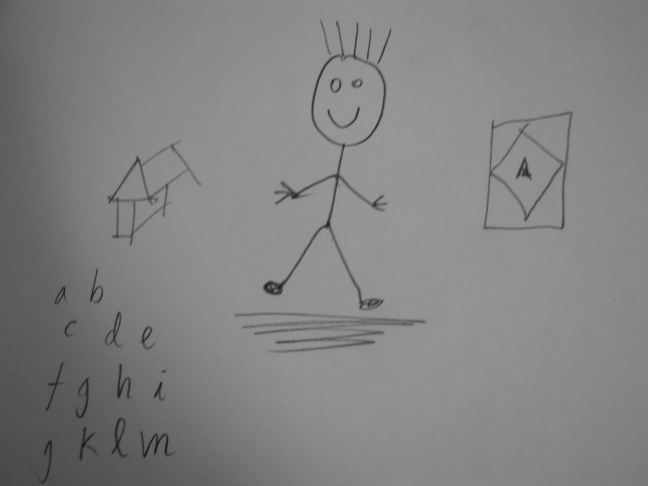

time: 12 s (started: 2022-02-23 22:15:28 +00:00)


In [30]:
# Diccionario con tuplas de imágenes
Dicc_Images = {
    '012': ('uch012a.jpg','uch012b.jpg'),
    '084': ('uch084a.jpg','uch084b.jpg'),
    '098': ('uch098a.jpg','uch098b.jpg'),
    '101': ('uch101a.jpg','uch101b.jpg'),
}
for keys in Dicc_Images: # Se itera sobre el diccionario
  img1 = cv2.imread(Dicc_Images[keys][1],0) # Se lee la imagen correspondiente al sector a buscar
  img2 = cv2.imread(Dicc_Images[keys][0],0) # Se lee la imagen correspondiente al elemento objetivo

  # Se crea una copia de ambas imágenes
  Cache_Img2 = img2.copy() 
  Cache_Img1 = img1.copy()

  sift = cv2.SIFT_create()
  # Se generan los puntos de interés y los descriptores
  kp1, des1 = sift.detectAndCompute(img1,None)
  kp2, des2 = sift.detectAndCompute(img2,None)

  bf = cv2.BFMatcher()
  matches = bf.knnMatch(des1,des2, k=2) # Se generan los matches
  points1, points2, good = filterMatches(matches) # Se filtran los matches

  img_match = cv2.drawMatches(img1,kp1,img2,kp2,good, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

  print('Matches preliminares:')
  cv2_imshow(img_match)

  # RANSAC:
  #1) Obtener los calces aceptados a partir de la función ransac(good, kp2, kp1)
  Calces = ransac(good, kp1, kp2)
  #2) Dibujar los calces aceptados
  
  img_match = cv2.drawMatches(img1,kp1,img2,kp2,Calces, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
  print('Matches aceptados por RANSAC:')
  cv2_imshow(img_match)
  # 3) Calcular la transformacion afin
  Trf_Afin_Img = calcAfin(Calces, kp1, kp2)
  # 4) Dibujar la imagen con el romboide superpuesto
  print('Ubicación del elemento de interés:')
  drawProjAfin(Trf_Afin_Img, img2, img1)
  

  # Hough:
  #1) Obtener los calces aceptados a partir de la función ransac(good, kp2, kp1)
  Calces = hough4d(good, kp1, kp2)
  #2) Dibujar los calces aceptados
  img_match = cv2.drawMatches(Cache_Img1,kp1,Cache_Img2,kp2,Calces, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
  print('Matches aceptados por Hough:')
  cv2_imshow(img_match)
  # 3) Calcular la transformacion afin
  Trf_Afin_Img = calcAfin(Calces, kp1, kp2)
  # 4) Dibujar la imagen con el romboide superpuesto
  print('Ubicación del elemento de interés:')
  drawProjAfin(Trf_Afin_Img, Cache_Img2, Cache_Img1)


Matches preliminares:


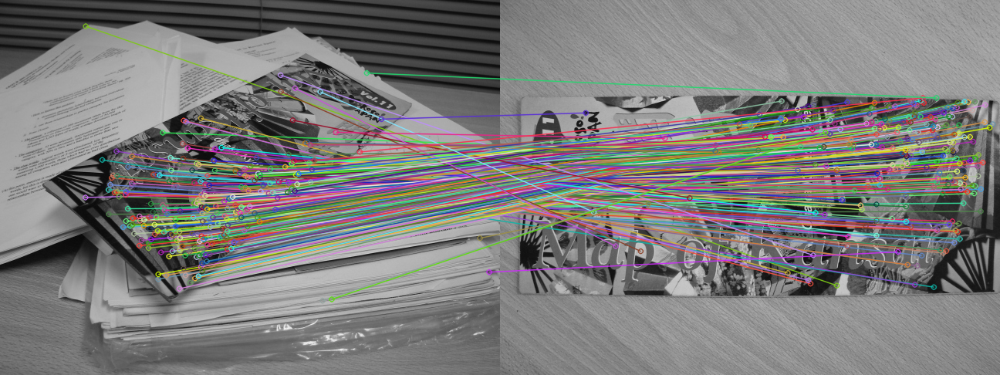

Parámetros de RANSAC: (100, 2, 1000)


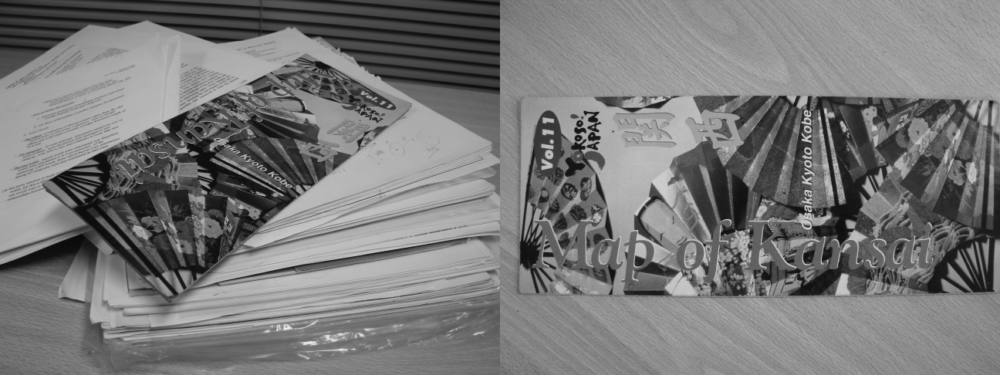

No hay suficiente cantidad de calces para poder realizar la transformación.
Se retorna la imagen sin el romboide.


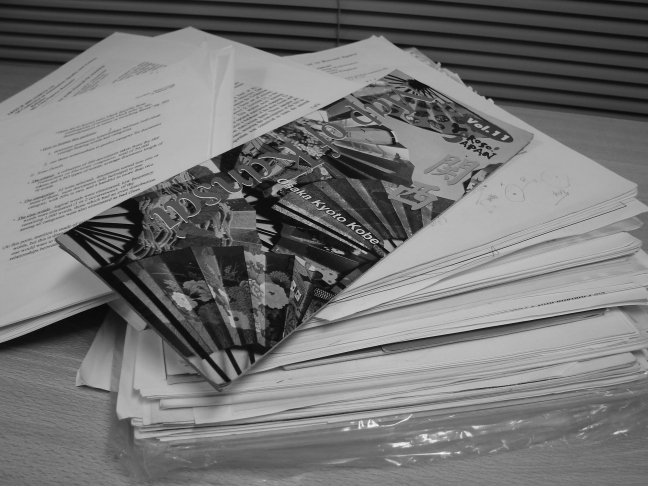

Parámetros de Hough: (60, 30, 25)


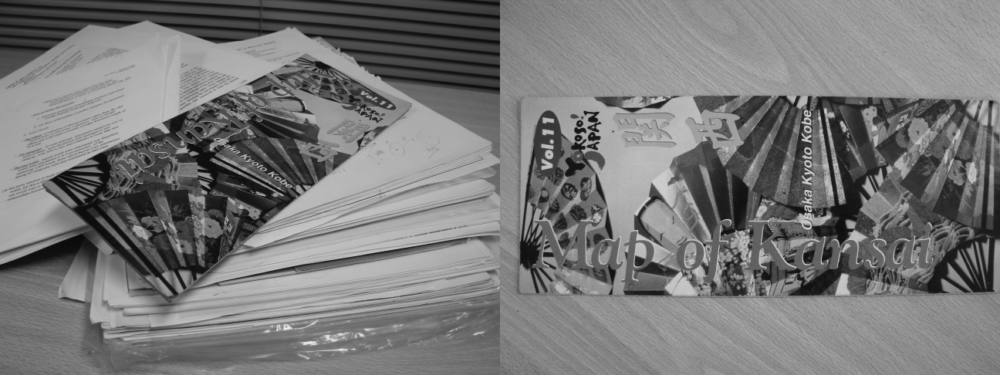

No hay suficiente cantidad de calces para poder realizar la transformación.
Se retorna la imagen sin el romboide.


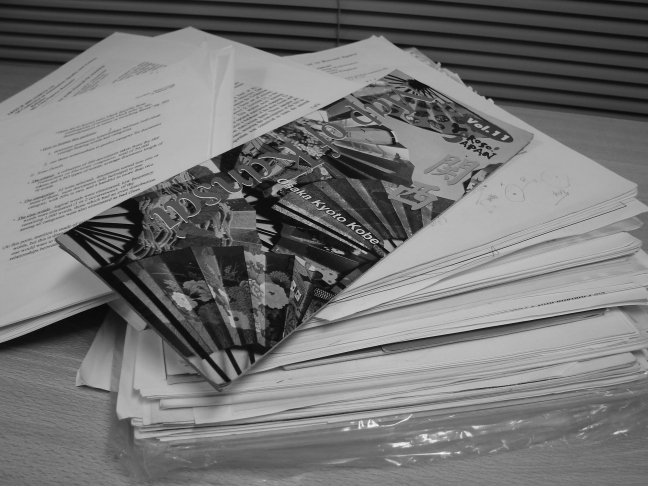

Parámetros de RANSAC: (100, 240, 5)


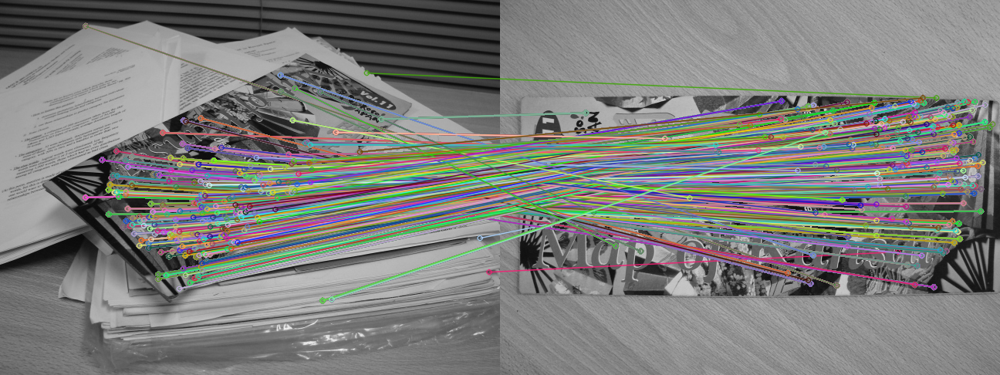

[701, 171]
[370, -84]
[325, 427]
[-5, 172]
[701, 171]


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  


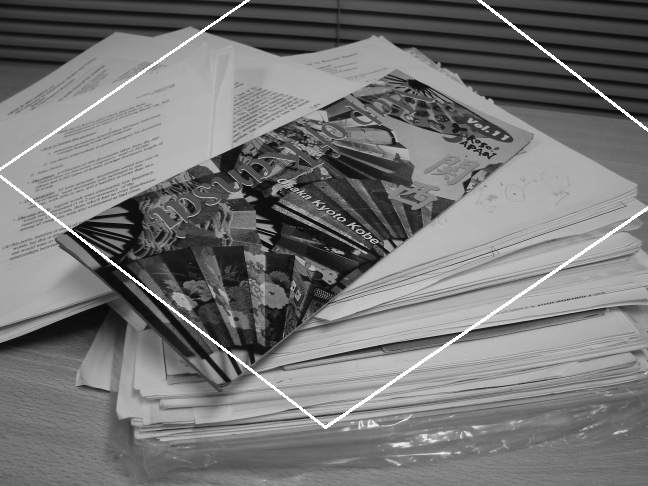

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:34: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:35: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecat

Parámetros de Hough: (60, 30, 1)


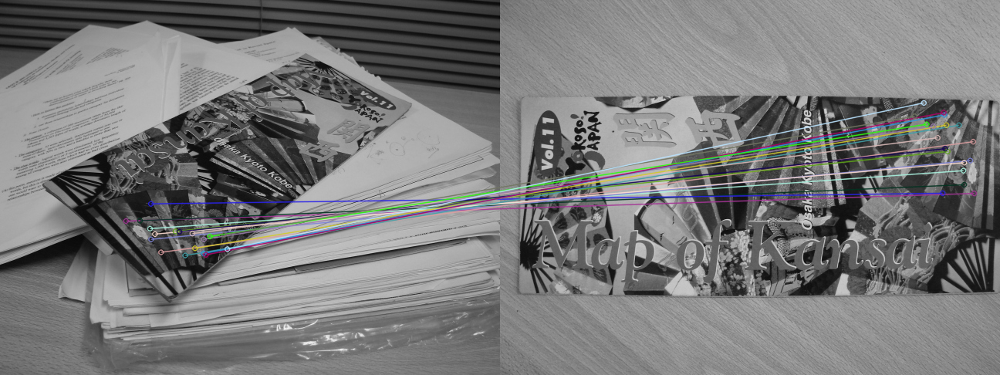

[809, 89]
[475, -215]
[308, 462]
[-25, 157]
[809, 89]


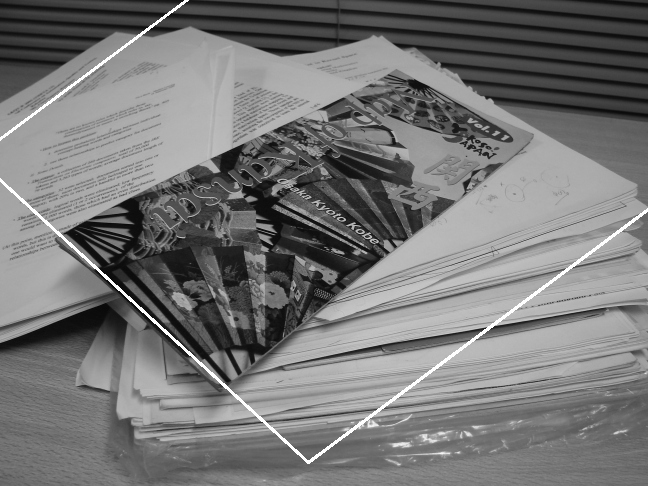

Parámetros de RANSAC: (2, 100, 30)


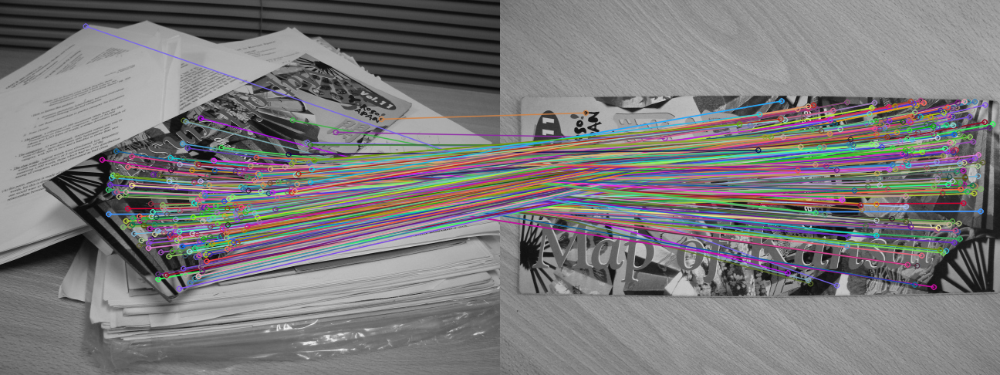

[713, 144]
[393, -117]
[316, 436]
[-4, 174]
[713, 144]


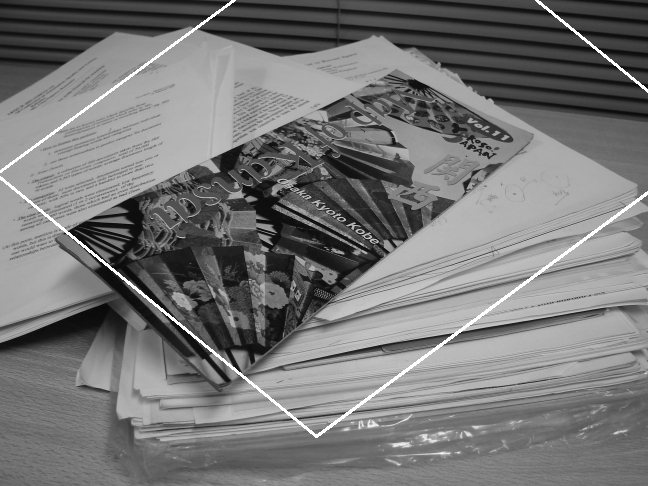

Parámetros de Hough: (25, 10, 4)


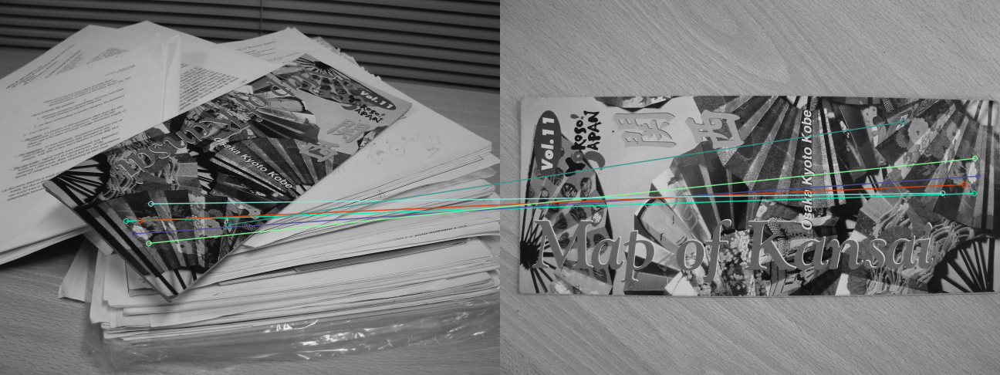

[800, 95]
[483, -201]
[300, 457]
[-17, 161]
[800, 95]


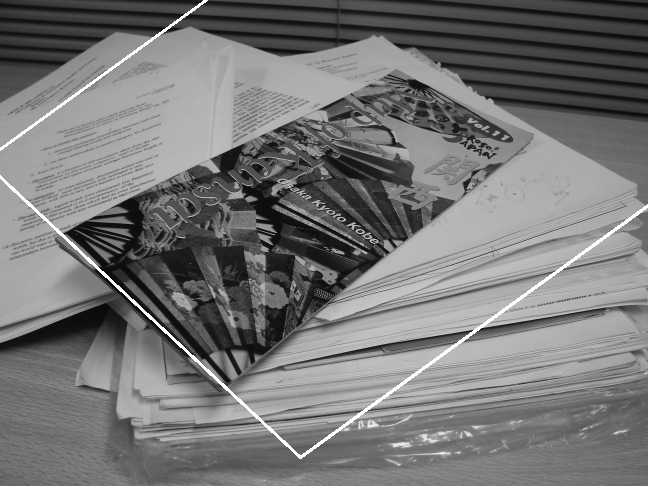

Parámetros de RANSAC: (700, 100, 30)


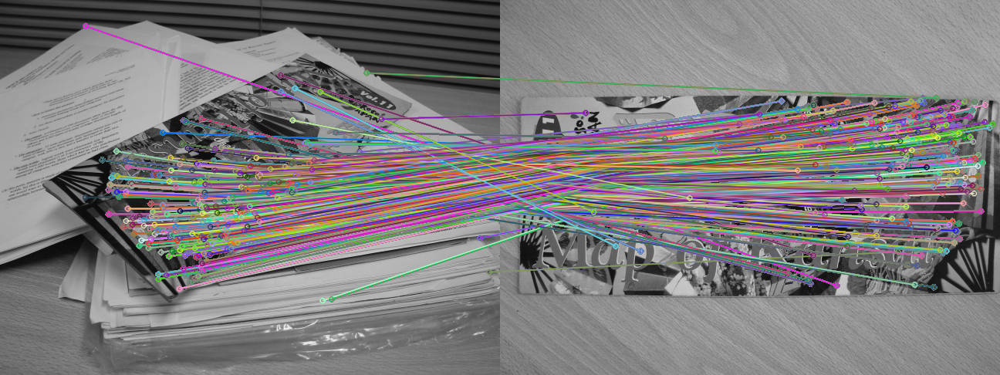

[709, 150]
[393, -99]
[315, 429]
[0, 179]
[709, 150]


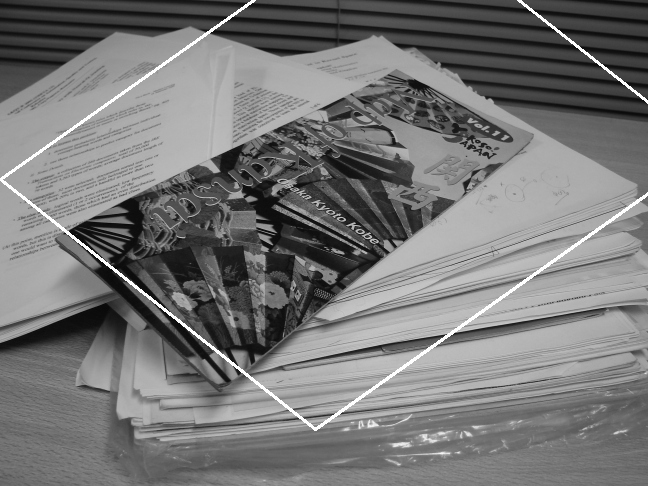

Parámetros de Hough: (240, 90, 4)


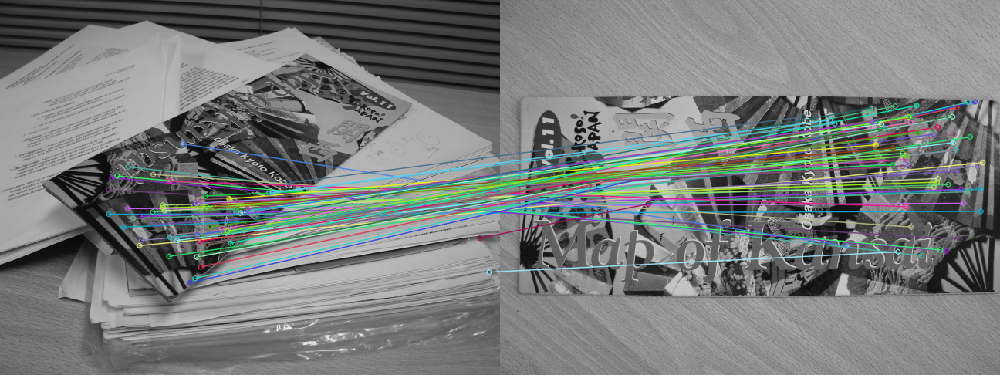

[837, 256]
[686, 80]
[220, 377]
[69, 202]
[837, 256]


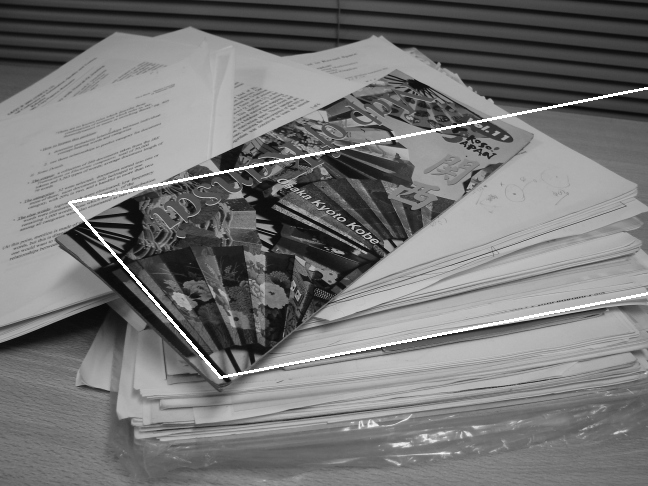

Parámetros de RANSAC: (700, 240, 5)


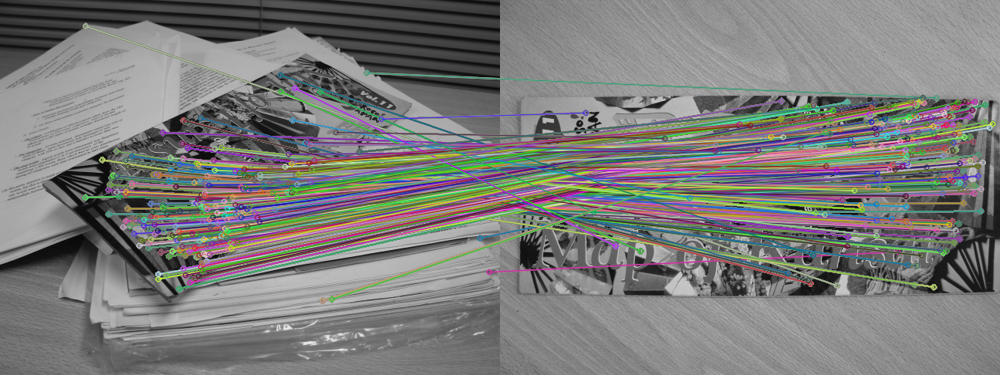

[700, 171]
[370, -84]
[325, 427]
[-5, 172]
[700, 171]


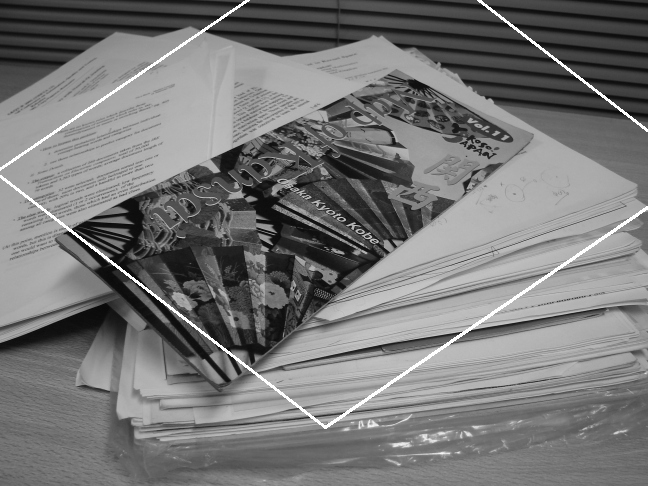

Parámetros de Hough: (360, 120, 4)


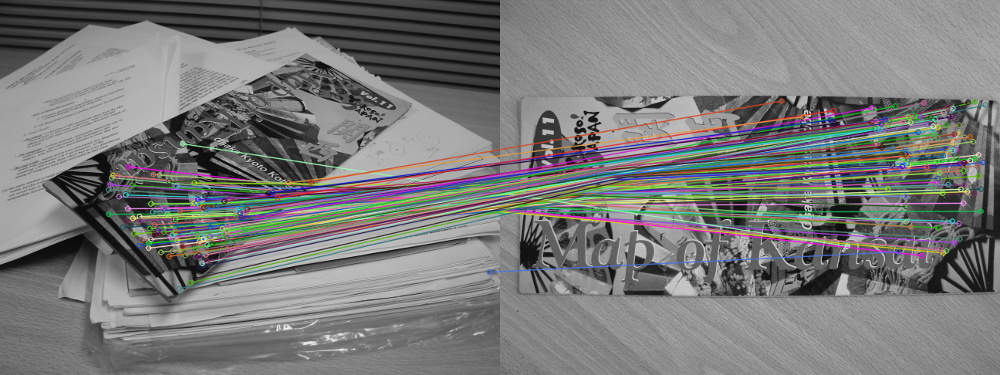

[776, 124]
[542, -117]
[268, 431]
[34, 189]
[776, 124]


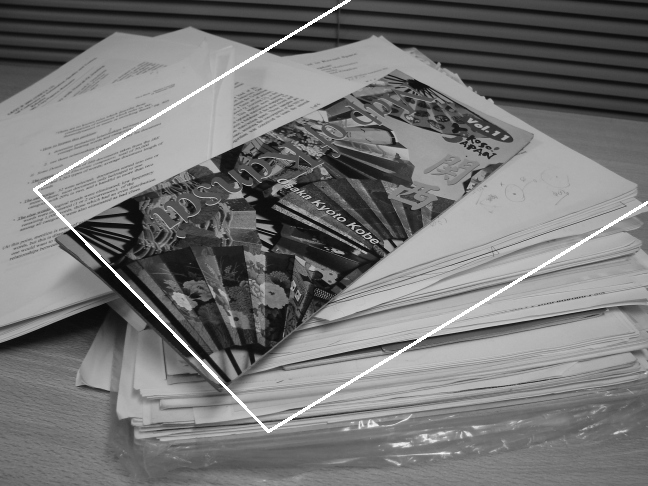

time: 29.1 s (started: 2022-02-23 22:16:08 +00:00)


In [31]:
img2 = cv2.imread(Dicc_Images['098'][0],0)
img1 = cv2.imread(Dicc_Images['098'][1],0)

Cache_Img2 = img2.copy()
Cache_Img1 = img1.copy()

sift = cv2.SIFT_create()

kp1, des1 = sift.detectAndCompute(img1,None)
kp2, des2 = sift.detectAndCompute(img2,None)

bf = cv2.BFMatcher()
matches = bf.knnMatch(des1,des2, k=2)
points1, points2, good = filterMatches(matches)

img_match = cv2.drawMatches(img1,kp1,img2,kp2,good, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

print('Matches preliminares:')
cv2_imshow(img_match)

Dicc_Valores_RANSAC = {
    'Valor_1': (100,2,1000),
    'Valor_2': (100,240,5),
    'Valor_3': (2,100,30),
    'Valor_4': (700,100,30),
    'Valor_5': (700,240,5),
}
Dicc_Valores_Hough = { #60,30,4
    'Valor_1': (60,30,25),
    'Valor_2': (60,30,1),
    'Valor_3': (25,10,4),
    'Valor_4': (240,90,4),
    'Valor_5': (360,120,4)
}

for keys in Dicc_Valores_RANSAC:

  # RANSAC:
  Cache_Img2_RANSAC = img2.copy()
  Cache_Img1_RANSAC = img1.copy()
  print('Parámetros de RANSAC:',Dicc_Valores_RANSAC[keys] )
  #1) Obtener los calces aceptados a partir de la función ransac(good, kp2, kp1)
  Calces = ransac(good, kp1, kp2, Dicc_Valores_RANSAC[keys][0], Dicc_Valores_RANSAC[keys][1], Dicc_Valores_RANSAC[keys][2])
  #2) Dibujar los calces aceptados
  img_match = cv2.drawMatches(Cache_Img1_RANSAC,kp1,Cache_Img2_RANSAC,kp2,Calces, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

  cv2_imshow(img_match)
  # 3) Calcular la transformacion afin
  Trf_Afin_Img = calcAfin(Calces, kp1, kp2)
  drawProjAfin(Trf_Afin_Img, Cache_Img2_RANSAC, Cache_Img1_RANSAC)
  # 4) Dibujar la imagen con el romboide superpuesto

  # Hough:
  Cache_Img2_Hough = img2.copy()
  Cache_Img1_Hough = img1.copy()
  print('Parámetros de Hough:',Dicc_Valores_Hough[keys] )
  #1) Obtener los calces aceptados a partir de la función ransac(good, kp2, kp1)
  Calces = hough4d(good, kp1, kp2, Dicc_Valores_Hough[keys][0], Dicc_Valores_Hough[keys][1], Dicc_Valores_Hough[keys][2])
  #2) Dibujar los calces aceptados
  img_match = cv2.drawMatches(Cache_Img1_Hough,kp1,Cache_Img2_Hough,kp2,Calces, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
  cv2_imshow(img_match)
  # 3) Calcular la transformacion afin
  Trf_Afin_Img = calcAfin(Calces, kp1, kp2)
  # 4) Dibujar la imagen con el romboide superpuesto
  drawProjAfin(Trf_Afin_Img, Cache_Img2_Hough, Cache_Img1_Hough)

